## Network Analytics Ft. Adani Saga 2023 

<i>Date of Project Completion: Feb 15, 2023</i>

Let's focus our attention towards one of the most influential and successful businessman from India who rose to a global recognition as he rocked the top charts of being one of the richest people in the world. However, recently, <b>Gautam Adani</b>, the chairman and founder of the Adani Group has been accused of some trickery and we decided to take that up as our network analytics project topic. We went ahead and analyzed how twitteratis reacted to the whole situation and not surprisingly, it looks like another political debate in the country. 

<b>Let's get some context before we dive into the analytics part:</b> \
Adani is a big name not only in India but also globally. It’s been about three weeks since Hindenburg, a New York-based short-selling firm, accused Adani Group of “pulling the largest con in corporate history” through stock manipulation, and accounting fraud. In response to Hindenburg’s allegations, Adani Group issued a 413-page reply calling the short-sellers claims “stale, baseless, and discredited allegations.” This spiked a sort-of political debate in the country and people started questioning whether the political leaders in power had something to do with these Adani scams. We started witnessing a ton of twitter riots, the obvious memes, and also the propagation of speculated information that lacks evidence. 

The allegations have nevertheless had an immediate knock-on effect, with more than $100 billion wiped from the group’s market value, as well as Gautam Adani losing his status as both Asia and India’s richest man. With the context set, now we proceed to the analysis.

<b>Importing the required libraries:</b>

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import networkx as nx
import copy

# Newtork 01: Supporters 

<b>Loading the required datasets scrapped from Twitter:</b> 

In [3]:
df = pd.read_csv('Positive.csv', index_col = [0])
df1 = df[['screen_name','Tweet']]
df1.head()

,screen_name,Tweet
0,ImRaJSharma,RT @sekar_991: #IStandwithAdani No foreigner c...
1,ImRaJSharma,RT @IMSanjuChauhan: i stand with Adani Ji!\n @...
2,ImRaJSharma,RT @rohanpandya: Adani is not SINKING 🔥#istand...
3,ImRaJSharma,RT @StringReveals: Uncovering the truth behind...
4,ImRaJSharma,RT @StringReveals: This video will satisfy all...


<b>Extracting the user account ID's:</b>
>Example: @whyruchiwhy :P

In [4]:
def find_retweet(s):
    retweet = re.findall('RT \@[^\s\:]+',s)  
    try:
        retweet = retweet[0][4:]        
    except IndexError:
        retweet = None        
    return retweet

<b>Identifying Tweets and RTs to form elements of the Network Graph:</b>

In [5]:
df1['ReTweeter'] = df1['Tweet'].apply(find_retweet)
df1.rename(columns = {"screen_name": "Tweeter"}, inplace = True)
df1.head() # where new is None that is OG not retweet

,Tweeter,Tweet,ReTweeter
0,ImRaJSharma,RT @sekar_991: #IStandwithAdani No foreigner c...,sekar_991
1,ImRaJSharma,RT @IMSanjuChauhan: i stand with Adani Ji!\n @...,IMSanjuChauhan
2,ImRaJSharma,RT @rohanpandya: Adani is not SINKING 🔥#istand...,rohanpandya
3,ImRaJSharma,RT @StringReveals: Uncovering the truth behind...,StringReveals
4,ImRaJSharma,RT @StringReveals: This video will satisfy all...,StringReveals


In [6]:
arr = []
for elem in df1['ReTweeter']:
    if elem == None:
        arr.append('Tweet')
    else:
        arr.append('Retweet')
        
df1['Type'] = arr
df2 = df1[['Tweeter', 'ReTweeter', 'Type']]
# df2.to_csv('gephi_file1.csv') 

df2[df2['Type'] == 'Tweet'].head()

,Tweeter,ReTweeter,Type
23,MadhavanIndian,None,Tweet
32,manishraghav,None,Tweet
46,lalitmish,None,Tweet
55,ProudIndianzz,None,Tweet
59,rajendran5810,None,Tweet


In [7]:
df3 = df2[df2['Type']!='Tweet'].copy()
df3[df3['Type']=='Retweet'].head()

,Tweeter,ReTweeter,Type
0,ImRaJSharma,sekar_991,Retweet
1,ImRaJSharma,IMSanjuChauhan,Retweet
2,ImRaJSharma,rohanpandya,Retweet
3,ImRaJSharma,StringReveals,Retweet
4,ImRaJSharma,StringReveals,Retweet


In [8]:
df3['nodes'] = df3[['Tweeter', 'ReTweeter']].apply(tuple, axis=1)

g = nx.DiGraph()  
g.add_edges_from(df3['nodes'])
df3['nodes']

0                (ImRaJSharma, sekar_991)
1           (ImRaJSharma, IMSanjuChauhan)
2              (ImRaJSharma, rohanpandya)
3            (ImRaJSharma, StringReveals)
4            (ImRaJSharma, StringReveals)
                      ...                
9320         (Uma08672028, StringReveals)
9321    (JD123928663301, ravindrayadav__)
9322           (NaMoBhagt, StringReveals)
9323      (JD123928663301, the_none_joyy)
9324         (chinesevirus90, FuriaVivek)
Name: nodes, Length: 8649, dtype: object

<b>Plot the Network:</b>

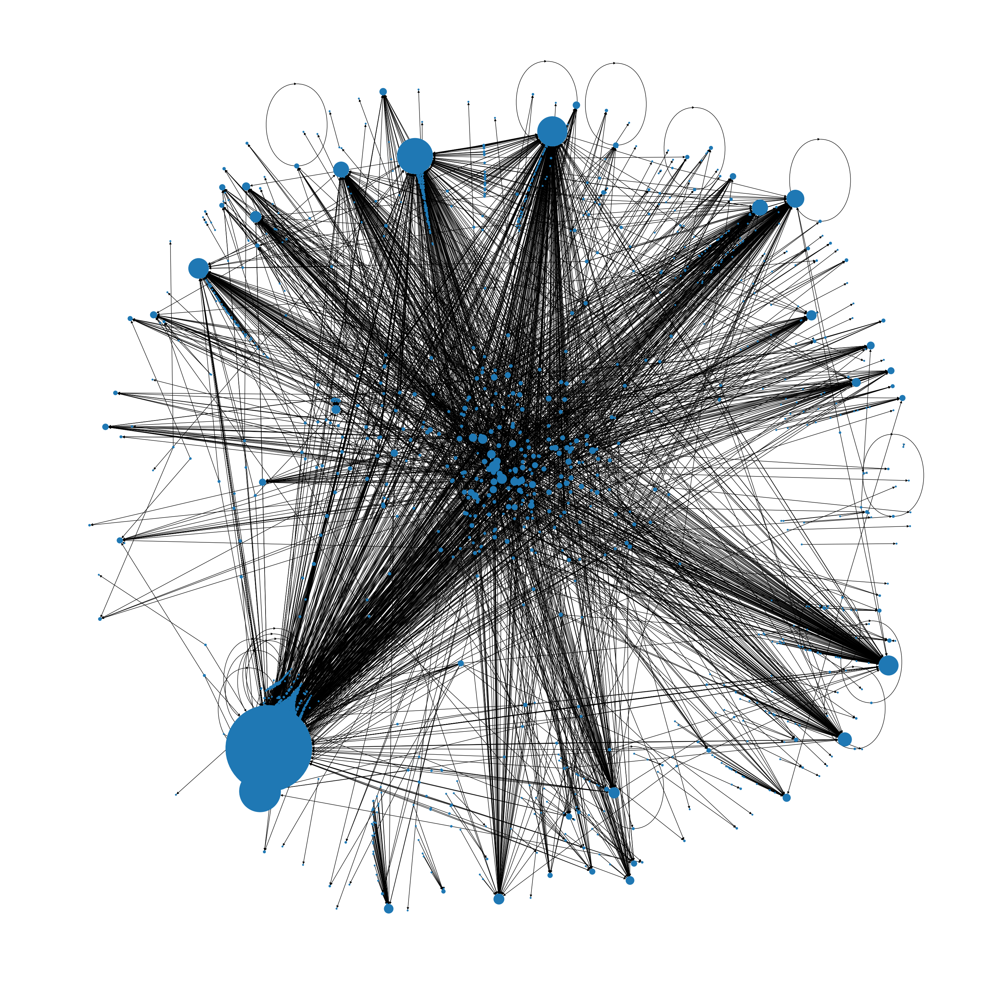

In [13]:
plt.figure(figsize = (30, 30))

size = [g.degree(node) * 10 for node in g.nodes()]
nx.draw(g,  node_size = size, font_size = 12)  
plt.show()

The networkx graph is super dense (but beautiful, so much data) which makes it difficult to interpret. We use Gephi to plot the network graphs instead that are summarized in the presentation. 

<b>Creating Dictionaries for Centrality Measures:</b>

In [9]:
degree = nx.degree_centrality(g)
between = nx.betweenness_centrality(g)
close = nx.closeness_centrality(g)

In [10]:
metrics_df = pd.DataFrame([degree, between,close]).T
metrics_df.reset_index(inplace = True)
metrics_df.columns = ['username','degree','between','close']
metrics_df.head()

,username,degree,between,close
0,ImRaJSharma,0.001129,0.000000,0.000000
1,sekar_991,0.010722,0.000000,0.011010
2,IMSanjuChauhan,0.006020,0.000000,0.006020
3,rohanpandya,0.112491,0.000000,0.112764
4,StringReveals,0.659330,0.000241,0.659889


<b>Forming a score to rank the influencers and find the top most influencing nodes:</b>

In [38]:
user_a_retweets_tweets = pd.pivot_table(df3[['Tweeter', 'ReTweeter', 'Type']], 
                                        index = 'Tweeter', 
                                        columns = 'Type', 
                                        aggfunc = "count", 
                                        fill_value = 0).reset_index()

user_a_retweets_tweets.columns = user_a_retweets_tweets.columns.get_level_values(0)
user_a_retweets_tweets.columns = ['username', 'retweets_sent']
user_a_retweets_tweets.head()

,username,retweets_sent
0,007CryptoCap,1
1,04pankajtanwar,1
2,05BiOK5HCs7hGO7,1
3,088a7babc97c412,1
4,11thShubham,2


In [39]:
user_b_retweets_tweets = pd.pivot_table(df3[['Tweeter', 'ReTweeter', 'Type']], 
                                        index = 'ReTweeter', 
                                        columns = 'Type', 
                                        aggfunc = "count", 
                                        fill_value = 0).reset_index()

user_b_retweets_tweets.columns = user_b_retweets_tweets.columns.get_level_values(0)
user_b_retweets_tweets.columns = ['username', 'retweets_rec']
user_b_retweets_tweets.head()

,ReTweeter,Tweeter
0,ANALYSTAKMISHRA,6
1,ASHOKPBJP,7
2,Ajiamsingh,1
3,AmithRajput7,1
4,Amolk1985,1


In [41]:
retweets_df = user_a_retweets_tweets.merge(user_b_retweets_rec, how = 'outer', on='username').fillna(0)
retweets_df.head()

,username,retweets_sent,retweets_rec
0,007CryptoCap,1.0,0.0
1,04pankajtanwar,1.0,0.0
2,05BiOK5HCs7hGO7,1.0,0.0
3,088a7babc97c412,1.0,0.0
4,11thShubham,2.0,0.0


In [42]:
final_df = df[['screen_name', 'listed_count', 'followers_count'
                                     ]].drop_duplicates().merge(retweets_df, how = 'left', 
                                                        left_on = 'screen_name', right_on = 'username')

final_df.head()

,screen_name,listed_count,followers_count,username,retweets_sent,retweets_rec
0,ImRaJSharma,0.0,15.0,ImRaJSharma,8.0,0.0
1,chandra15053,0.0,20.0,chandra15053,1.0,0.0
2,DikitaAmin,0.0,12.0,DikitaAmin,1.0,0.0
3,Rudra50042283,0.0,255.0,Rudra50042283,1.0,0.0
4,bharath91970067,0.0,9.0,bharath91970067,1.0,0.0


In [43]:
final_df = final_df.drop(['username'], axis=1)

for i in final_df.iloc[:, 1:]:
  
    mean = final_df[i].mean()
    std = final_df[i].std()
    
    final_df[i] -= mean
    final_df[i] /= std

In [44]:
final_df.head(10)

,screen_name,listed_count,followers_count,retweets_sent,retweets_rec
0,ImRaJSharma,-0.123471,-0.093549,2.494990,-0.028274
1,chandra15053,-0.123471,-0.092827,-0.257465,-0.028274
2,DikitaAmin,-0.123471,-0.093983,-0.257465,-0.028274
3,Rudra50042283,-0.123471,-0.058884,-0.257465,-0.028274
4,bharath91970067,-0.123471,-0.094416,-0.257465,-0.028274
5,ashishmehta_77,-0.044649,-0.067839,-0.257465,-0.028274
6,PawanRealSingh1,-0.123471,-0.095282,0.135743,-0.028274
7,manis_kumar,0.940636,0.005247,-0.257465,-0.028274
8,Angelic_Quest,-0.005237,0.618102,-0.257465,-0.028274
9,Himanshu_rathod,-0.123471,-0.094849,-0.257465,-0.028274


In [45]:
final_df.drop_duplicates(inplace=True)

# merge network stats with twitter stats
final_df2 = metrics_df.merge(final_df, right_on = "screen_name", left_on = "username")

final_df2.iloc[0]

username           ImRaJSharma
degree                0.001129
between                    0.0
close                      0.0
screen_name        ImRaJSharma
listed_count         -0.123471
followers_count      -0.093549
retweets_sent          2.49499
retweets_rec         -0.028274
Name: 0, dtype: object

In [48]:
a, b, c, d, e, f, h = 1, 1, 1, 1, 1, 1, 1

final_df2['score'] = final_df2['degree']*a \
                    + final_df2['between']*b\
                    + final_df2['close']*c\
                    + final_df2['listed_count']*d\
                    + final_df2['followers_count']*e\
                    + final_df2['retweets_sent']*f\
                    + final_df2['retweets_rec']*h

<b>Top 30 inluencers in the Network:</b>

In [49]:
top_influencers= final_df2.sort_values(by='score', ascending=False).rename(columns = {'between': "betweeness",
                                                                     'close': 'closeness'})
top20 = top_influencers['username'].iloc[:40].values
top_influencers.iloc[:30]

,username,degree,betweeness,closeness,screen_name,listed_count,followers_count,retweets_sent,retweets_rec,score
4,StringReveals,0.659330,2.414863e-04,0.659889,StringReveals,8.783499,35.686893,0.135743,41.518206,87.443802
3,StringReveals,0.659330,2.414863e-04,0.659889,StringReveals,8.783499,35.682415,0.135743,41.518206,87.439324
2,StringReveals,0.659330,2.414863e-04,0.659889,StringReveals,8.783499,35.682271,0.135743,41.518206,87.439180
6,Voice_For_India,0.151618,0.000000e+00,0.432874,Voice_For_India,7.719392,25.595947,-0.650672,7.493393,40.742552
5254,irajdeep,0.000188,0.000000e+00,0.000000,irajdeep,31.405629,4.853199,-0.257465,-0.028274,35.973278
73,Rajibsa95,0.010346,0.000000e+00,0.000000,Rajibsa95,-0.123471,-0.093260,25.694254,-0.028274,25.459594
1962,pvsubramanyam,0.000188,0.000000e+00,0.000188,pvsubramanyam,16.941654,5.912371,-0.650672,-0.018942,22.184787
2333,TeamBakshi3,0.008277,0.000000e+00,0.000000,TeamBakshi3,-0.084060,0.090611,21.368967,-0.028274,21.355520
143,OTTlatest,0.007148,0.000000e+00,0.000000,OTTlatest,-0.084060,0.701732,19.009720,-0.028274,19.606266
3491,prasanto,0.001129,0.000000e+00,0.001344,prasanto,14.813440,3.270581,-0.650672,0.027718,17.463539


<b>Network Graph without top 30 influencers:</b>

In [51]:
df3_wo_top20= df3[~(df3['Tweeter'].isin(top20)) & ~(df3['ReTweeter'].isin(top20))]
df3_wo_top20.head()

,Tweeter,ReTweeter,Type,nodes
0,ImRaJSharma,sekar_991,Retweet,"(ImRaJSharma, sekar_991)"
1,ImRaJSharma,IMSanjuChauhan,Retweet,"(ImRaJSharma, IMSanjuChauhan)"
2,ImRaJSharma,rohanpandya,Retweet,"(ImRaJSharma, rohanpandya)"
5,ImRaJSharma,SelfDoubtist,Retweet,"(ImRaJSharma, SelfDoubtist)"
35,Solanki65887483,PriyaNethra2,Retweet,"(Solanki65887483, PriyaNethra2)"


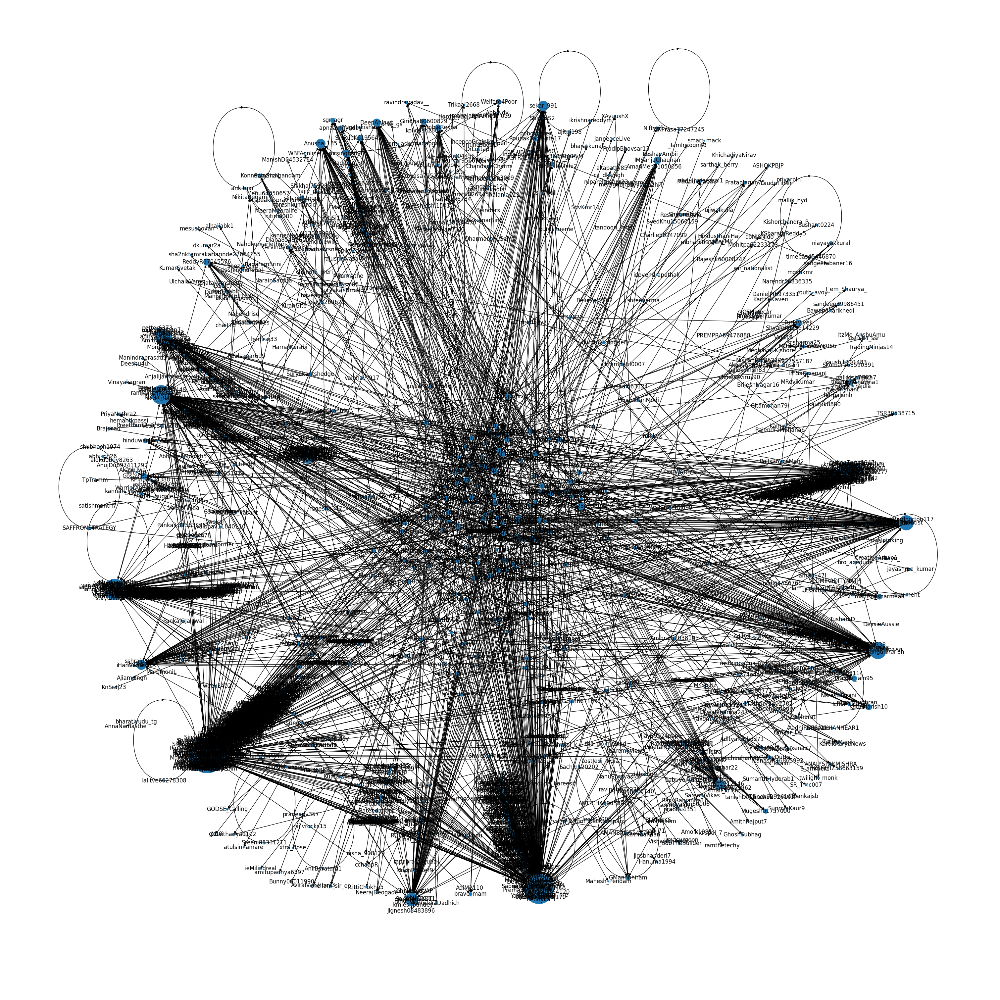

In [52]:
df3_wo_top20['nodes'] = df3_wo_top20[['Tweeter', 'ReTweeter']].apply(tuple, axis=1)

g = nx.DiGraph()  
g.add_edges_from(df3_wo_top20['nodes'])
df3_wo_top20['nodes']

plt.figure(figsize = (30, 30))

size = [g.degree(node) * 10 for node in g.nodes()]
nx.draw(g, with_labels = True, node_size = size, font_size = 12)  

plt.show()

# Network 02: Opposers 

In [55]:
ndf = pd.read_csv('Negative.csv').iloc[:,1:]
ndf.head()

,id,id_str,name,screen_name,location,description,url,entities,protected,followers_count,...,has_extended_profile,default_profile,default_profile_image,following,follow_request_sent,notifications,translator_type,withheld_in_countries,Tweet,Retweet_count
0,3.277756e+09,3277756314,Ruth Leahy,Petitioner007,Yuibera Country,Queensland Legal Field Corruption Whistleblowe...,NaN,{'description': {'urls': []}},0.0,2801.0,...,1.0,0.0,0.0,0.0,0.0,0.0,none,[],⬇️ Aust also needs to expose who in Federal La...,0.0
1,1.450729e+18,1450728752787247108,Solarpunk_Bot,Solarpunk_Bot,NaN,Bot that retweets mentions of Solarpunk for an...,https://t.co/VFKDTmQdmN,{'url': {'urls': [{'url': 'https://t.co/VFKDTm...,False,1037.0,...,True,True,False,False,False,False,none,[],RT @BrendaChoi19: Tim Wilson: Stopping Adani a...,1.0
2,1.586305e+18,1586305342945693696,Yin Chung,MinghauHK,NaN,NaN,NaN,{'description': {'urls': []}},False,60.0,...,True,True,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0
3,9.905981e+07,99059813,Mark Smith,marksmithsydney,Sydney,Darlinghurst resident passionate about the env...,NaN,{'description': {'urls': []}},False,821.0,...,True,False,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0
4,1.329719e+18,1329718948678365185,🧐 love is… love is not…,RealiTYsGone,WalleMyBestFriendEver&MoLuvYa,nobody 🥰,NaN,{'description': {'urls': []}},False,149.0,...,True,True,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0


In [59]:
ndf_toappend = pd.read_csv('adani_negative_new_adaniscam.csv').iloc[:,1:]
ndf_toappend.columns
ndf = ndf.append(ndf_toappend[ndf.columns], ignore_index=True)
ndf.head()

,id,id_str,name,screen_name,location,description,url,entities,protected,followers_count,...,has_extended_profile,default_profile,default_profile_image,following,follow_request_sent,notifications,translator_type,withheld_in_countries,Tweet,Retweet_count
0,3.277756e+09,3.277756e+09,Ruth Leahy,Petitioner007,Yuibera Country,Queensland Legal Field Corruption Whistleblowe...,NaN,{'description': {'urls': []}},0.0,2801.0,...,1.0,0.0,0.0,0.0,0.0,0.0,none,[],⬇️ Aust also needs to expose who in Federal La...,0.0
1,1.450729e+18,1.450729e+18,Solarpunk_Bot,Solarpunk_Bot,NaN,Bot that retweets mentions of Solarpunk for an...,https://t.co/VFKDTmQdmN,{'url': {'urls': [{'url': 'https://t.co/VFKDTm...,False,1037.0,...,True,True,False,False,False,False,none,[],RT @BrendaChoi19: Tim Wilson: Stopping Adani a...,1.0
2,1.586305e+18,1.586305e+18,Yin Chung,MinghauHK,NaN,NaN,NaN,{'description': {'urls': []}},False,60.0,...,True,True,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0
3,9.905981e+07,9.905981e+07,Mark Smith,marksmithsydney,Sydney,Darlinghurst resident passionate about the env...,NaN,{'description': {'urls': []}},False,821.0,...,True,False,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0
4,1.329719e+18,1.329719e+18,🧐 love is… love is not…,RealiTYsGone,WalleMyBestFriendEver&MoLuvYa,nobody 🥰,NaN,{'description': {'urls': []}},False,149.0,...,True,True,False,False,False,False,none,[],RT @BobBrownFndn: A win for people defending I...,5.0


In [60]:
ndf1 = ndf[['screen_name','Tweet']]
ndf1.head()

,screen_name,Tweet
0,Petitioner007,⬇️ Aust also needs to expose who in Federal La...
1,Solarpunk_Bot,RT @BrendaChoi19: Tim Wilson: Stopping Adani a...
2,MinghauHK,RT @BobBrownFndn: A win for people defending I...
3,marksmithsydney,RT @BobBrownFndn: A win for people defending I...
4,RealiTYsGone,RT @BobBrownFndn: A win for people defending I...


In [61]:
def find_retweet(s):
    retweet = re.findall('RT \@[^\s\:]+',s)
    
    try:
        retweet = retweet[0][4:]
    except IndexError:
        retweet = None
    return retweet

In [62]:
ndf1['ReTweeter'] = ndf1['Tweet'].apply(find_retweet)
ndf1.rename(columns = {"screen_name": "Tweeter"}, inplace=True)
ndf1.head() # where new is None that is OG not retweet

,Tweeter,Tweet,ReTweeter
0,Petitioner007,⬇️ Aust also needs to expose who in Federal La...,None
1,Solarpunk_Bot,RT @BrendaChoi19: Tim Wilson: Stopping Adani a...,BrendaChoi19
2,MinghauHK,RT @BobBrownFndn: A win for people defending I...,BobBrownFndn
3,marksmithsydney,RT @BobBrownFndn: A win for people defending I...,BobBrownFndn
4,RealiTYsGone,RT @BobBrownFndn: A win for people defending I...,BobBrownFndn


In [63]:
arr = []
for elem in ndf1['ReTweeter']:
    if elem == None:
        arr.append('Tweet')
    else:
        arr.append('Retweet')
        
ndf1['Type'] = arr
ndf2 = df1[['Tweeter', 'ReTweeter', 'Type']]
ndf2.to_csv('gephi_anti_adani_all.csv')

In [64]:
import copy
ndf3 = ndf2.copy()

ndf3.loc[ndf3['ReTweeter'].isnull(), 'ReTweeter'] = ndf3['Tweeter']

In [65]:
ndf3['nodes'] = ndf3[['Tweeter', 'ReTweeter']].apply(tuple, axis=1)

g = nx.DiGraph()  
g.add_edges_from(ndf3['nodes'])
ndf3['nodes']

0                (ImRaJSharma, sekar_991)
1           (ImRaJSharma, IMSanjuChauhan)
2              (ImRaJSharma, rohanpandya)
3            (ImRaJSharma, StringReveals)
4            (ImRaJSharma, StringReveals)
                      ...                
9320         (Uma08672028, StringReveals)
9321    (JD123928663301, ravindrayadav__)
9322           (NaMoBhagt, StringReveals)
9323      (JD123928663301, the_none_joyy)
9324         (chinesevirus90, FuriaVivek)
Name: nodes, Length: 9325, dtype: object

In [66]:
degree = nx.degree_centrality(g)
between = nx.betweenness_centrality(g)
close = nx.closeness_centrality(g)

In [67]:
nmetrics_df = pd.DataFrame([degree, between, close]).T
nmetrics_df.reset_index(inplace = True)
nmetrics_df.columns = ['username','degree','between','close']
nmetrics_df.head()

,username,degree,between,close
0,ImRaJSharma,0.001073,0.000000,0.000000
1,sekar_991,0.010197,0.000000,0.010471
2,IMSanjuChauhan,0.005725,0.000000,0.005725
3,rohanpandya,0.107335,0.000000,0.107237
4,StringReveals,0.627370,0.000218,0.627544


In [90]:
nuser_a_retweets_tweets = pd.pivot_table(ndf3[['Tweeter', 'ReTweeter', 'Type']], 
                                        index = 'Tweeter', 
                                        columns = 'Type', 
                                        aggfunc = "count", 
                                        fill_value = 0).reset_index()

nuser_a_retweets_tweets.columns = nuser_a_retweets_tweets.columns.get_level_values(0)
nuser_a_retweets_tweets.columns = ['username', 'retweets_sent', "new"]
nuser_a_retweets_tweets.head()

,username,retweets_sent,new
0,007CryptoCap,1,0
1,04pankajtanwar,1,0
2,05BiOK5HCs7hGO7,1,0
3,088a7babc97c412,1,0
4,11thShubham,2,0


In [92]:
nuser_b_retweets_tweets = pd.pivot_table(ndf3[['Tweeter', 'ReTweeter', 'Type']], 
                                        index = 'Tweeter', 
                                        columns = 'Type', 
                                        aggfunc = "count", 
                                        fill_value = 0).reset_index()

nuser_b_retweets_tweets.columns = nuser_b_retweets_tweets.columns.get_level_values(0)
nuser_b_retweets_tweets.columns = ['username', 'retweets_sent', "new2"]
nuser_b_retweets_tweets.head()

,username,retweets_sent,new2
0,007CryptoCap,1,0
1,04pankajtanwar,1,0
2,05BiOK5HCs7hGO7,1,0
3,088a7babc97c412,1,0
4,11thShubham,2,0


In [93]:
nretweets_df = nuser_a_retweets_tweets.merge(nuser_b_retweets_tweets, how = 'outer', on='username').fillna(0)
nretweets_df.head()

,username,retweets_sent_x,new,retweets_sent_y,new2
0,007CryptoCap,1,0,1,0
1,04pankajtanwar,1,0,1,0
2,05BiOK5HCs7hGO7,1,0,1,0
3,088a7babc97c412,1,0,1,0
4,11thShubham,2,0,2,0


In [94]:
nfinal_df = ndf[['screen_name', 'listed_count', 'followers_count'
                                     ]].drop_duplicates().merge(nretweets_df, how = 'left', 
                                                        left_on = 'screen_name', right_on = 'username')

nfinal_df.head()

,screen_name,listed_count,followers_count,username,retweets_sent_x,new,retweets_sent_y,new2
0,Petitioner007,18.0,2801.0,NaN,NaN,NaN,NaN,NaN
1,Solarpunk_Bot,17.0,1037.0,NaN,NaN,NaN,NaN,NaN
2,MinghauHK,0.0,60.0,NaN,NaN,NaN,NaN,NaN
3,marksmithsydney,18.0,821.0,NaN,NaN,NaN,NaN,NaN
4,RealiTYsGone,2.0,149.0,NaN,NaN,NaN,NaN,NaN


In [95]:
nfinal_df = nfinal_df.drop(['username'], axis=1)

for i in nfinal_df.iloc[:, 1:]:
  
    mean = nfinal_df[i].mean()
    std = nfinal_df[i].std()
    
    nfinal_df[i] -= mean
    nfinal_df[i] /= std

In [96]:
nfinal_df.head(10)

,screen_name,listed_count,followers_count,retweets_sent_x,new,retweets_sent_y,new2
0,Petitioner007,0.046930,-0.008058,NaN,NaN,NaN,NaN
1,Solarpunk_Bot,0.036085,-0.035765,NaN,NaN,NaN,NaN
2,MinghauHK,-0.148291,-0.051111,NaN,NaN,NaN,NaN
3,marksmithsydney,0.046930,-0.039157,NaN,NaN,NaN,NaN
4,RealiTYsGone,-0.126600,-0.049713,NaN,NaN,NaN,NaN
5,zoetrainor3151,-0.148291,-0.051943,NaN,NaN,NaN,NaN
6,land_shepherd,-0.148291,-0.051503,NaN,NaN,NaN,NaN
7,BobBrownFndn,16.543164,1.501279,NaN,NaN,NaN,NaN
8,JessieDaMol,-0.148291,-0.046006,NaN,NaN,NaN,NaN
9,hominigritz,-0.007298,-0.034712,NaN,NaN,NaN,NaN


In [97]:
nfinal_df.drop_duplicates(inplace=True)

# merge network stats with twitter stats
nfinal_df2 = nmetrics_df.merge(nfinal_df, right_on = "screen_name", left_on = "username")

nfinal_df2.iloc[0]

username           yashpandya100
degree                  0.000358
between                      0.0
close                        0.0
screen_name        yashpandya100
listed_count           -0.148291
followers_count        -0.051864
retweets_sent_x         0.325743
new                    -0.308593
retweets_sent_y         0.325743
new2                   -0.308593
Name: 0, dtype: object

In [100]:
a, b, c, d, e = 1, 1, 1, 1, 1

nfinal_df2['score'] = nfinal_df2['degree']*a \
                    + nfinal_df2['between']*b\
                    + nfinal_df2['close']*c\
                    + nfinal_df2['listed_count']*d\
                    + nfinal_df2['followers_count']*e

In [101]:
ntop_influencers= nfinal_df2.sort_values(by='score', ascending=False).rename(columns = {'between': "betweeness",
                                                                     'close': 'closeness'})
ntop20 = ntop_influencers['username'].iloc[:40].values
ntop_influencers.iloc[:30]

,username,degree,betweeness,closeness,screen_name,listed_count,followers_count,retweets_sent_x,new,retweets_sent_y,new2,score
121,SunjayJK,0.000358,0.000000e+00,0.000000,SunjayJK,12.606193,0.053467,-0.458842,2.402184,-0.458842,2.402184,12.660017
122,SunjayJK,0.000358,0.000000e+00,0.000000,SunjayJK,12.606193,0.053451,-0.458842,2.402184,-0.458842,2.402184,12.660002
158,mesushovan,0.000716,0.000000e+00,0.000358,mesushovan,1.814771,-0.040210,-0.458842,2.402184,-0.458842,2.402184,1.775635
37,drunkJournalist,0.007335,0.000000e+00,0.006981,drunkJournalist,0.600058,0.639387,-0.458842,1.046796,-0.458842,1.046796,1.253761
194,pavan_de,0.000179,0.000000e+00,0.000000,pavan_de,1.272489,-0.037932,-0.262696,-0.308593,-0.262696,-0.308593,1.234735
29,NdSolanki,0.000358,0.000000e+00,0.000000,NdSolanki,1.109804,-0.010712,-0.066550,-0.308593,-0.066550,-0.308593,1.099450
113,secureyoursites,0.001431,1.600384e-07,0.001252,secureyoursites,0.957965,0.037634,-0.262696,-0.308593,-0.262696,-0.308593,0.998283
151,Student4_Life,0.000179,0.000000e+00,0.000000,Student4_Life,0.882045,-0.029749,-0.066550,-0.308593,-0.066550,-0.308593,0.852475
87,BLRrocKS,0.000716,0.000000e+00,0.000358,BLRrocKS,0.610904,0.058226,-0.458842,1.046796,-0.458842,1.046796,0.670204
156,DUdawant,0.000179,0.000000e+00,0.000000,DUdawant,0.675978,-0.040210,-0.262696,-0.308593,-0.262696,-0.308593,0.635947


In [102]:
ndf3_wo_top20= ndf3[~(ndf3['Tweeter'].isin(ntop20)) & ~(ndf3['ReTweeter'].isin(ntop20))]
ndf3_wo_top20.head()

,Tweeter,ReTweeter,Type,nodes
0,ImRaJSharma,sekar_991,Retweet,"(ImRaJSharma, sekar_991)"
1,ImRaJSharma,IMSanjuChauhan,Retweet,"(ImRaJSharma, IMSanjuChauhan)"
2,ImRaJSharma,rohanpandya,Retweet,"(ImRaJSharma, rohanpandya)"
3,ImRaJSharma,StringReveals,Retweet,"(ImRaJSharma, StringReveals)"
4,ImRaJSharma,StringReveals,Retweet,"(ImRaJSharma, StringReveals)"


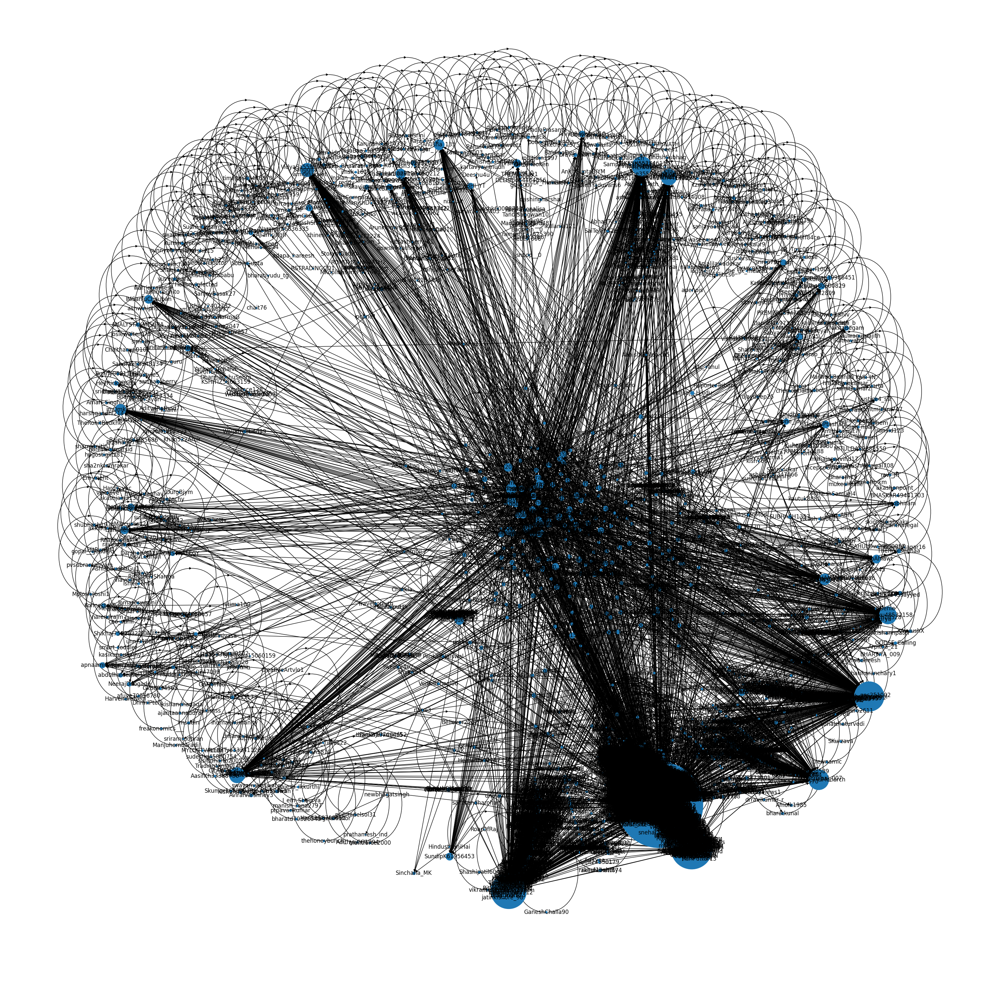

In [104]:
ndf3_wo_top20['nodes'] = ndf3_wo_top20[['Tweeter', 'ReTweeter']].apply(tuple, axis=1)

g = nx.DiGraph()  
g.add_edges_from(ndf3_wo_top20['nodes'])
ndf3_wo_top20['nodes']

plt.figure(figsize = (30, 30))

size = [g.degree(node) * 10 for node in g.nodes()]
nx.draw(g, with_labels = True, node_size = size, font_size = 12)  

plt.show()